# A simplified Version of Project Lab2
## from Supplement A: Microwave Radiometer Temperature and Humidity Retrieval

In [1]:
import sys
import traceback
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pn
import xarray as xr
import scipy.stats as stats

import pyOptimalEstimation as pyOE

%matplotlib inline
sns.set(style='ticks', palette='deep')

sys.path.append('lib')
import nonScatMWRadTran
import supporting_routines

/home/microway/anaconda3/lib/python3.9/site-packages/xarray/backends/cfgrib_.py:29: UserWarning: Failed to load cfgrib - most likely there is a problem accessing the ecCodes library. Try `import cfgrib` to get the full error message
  warnings.warn(
/home/microway/anaconda3/lib/python3.9/abc.py:106: FutureWarning: xarray subclass customProfile should explicitly define __slots__
  cls = super().__new__(mcls, name, bases, namespace, **kwargs)


In [2]:
def forwardRT(X, pressure=None, zenithAngle=0, frequencies=[]):

    # X contains T and Q, lets split the vector
    temperature, humidity = supporting_routines.splitTQ(X)
    # humdity is in log10 scale, convert to linear in kg/kg
    humidity = (10**humidity) / 1000.
    # Height in meters comes from index of the temperature (or humidty) vector
    heights = temperature.index
    assert np.all(np.diff(heights) > 0)

    # get absolute humidty from specific humdity
    abs_humidity = supporting_routines.q2a(humidity, pressure, temperature)
    
    # run the forward operator
    TB, tau, tau_wv, tau_o2 = nonScatMWRadTran.STP_IM10(
        heights,  # [m]  
        temperature,  # [K]
        pressure,  # [Pa]
        abs_humidity,  # [kgm^-3]
        zenithAngle,  # zenith angle of observation in deg.
        frequencies,  # frequency vector in GHz
    )
    return TB

# Load prior dataset
We start with loading the the previously prepared (see [lib/prepare_radiosondes.ipynb](lib/prepare_radiosondes.ipynb)) collection of radiosonde profiles at NSA from 04/2002 to 02/2020. We use the xarray library which provides a transparent interface to netCDF files so that we can directly copy the required variables form the netCDF file. The unit of temperature is Kelvin, specific humidity is provided in g/kg, and pressure is in Pa.


In [3]:
prior = xr.open_dataset('data/radiosonde_climatology_nsa_2002-2020.nc')

prior['q'] = np.log10(prior['q'])

Yobs_times = ['2006-01-15T00:00:00.000000000', '2006-02-15T00:00:00.000000000', '2006-03-15T00:00:00.000000000',
    '2006-04-15T00:00:00.000000000', '2006-05-15T00:00:00.000000000', '2006-06-15T00:00:00.000000000',
    '2006-07-15T00:00:00.000000000', '2006-08-15T00:00:00.000000000', '2006-09-15T00:00:00.000000000',
    '2006-10-15T00:00:00.000000000', '2010-11-15T00:00:00.000000000', '2006-12-15T00:00:00.000000000']

profileTT = np.array(Yobs_times,dtype='datetime64[ns]')

profiles = prior.sel(time=profileTT)
prior = prior.drop_sel(time=profileTT)
nLev = len(prior.height)

priors = {'all': prior}

months = [
    'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec',
]

Xa_month = 'Jan'

month_numbers = (
    [1], [2], [3], [4], [5], [6], [7], [8], [9], [10], [11], [12],
)
for month, month_number in zip(months, month_numbers):
    priors[month] = prior.where(
        np.in1d(prior['time.month'], month_number)[:, np.newaxis]).dropna(
            'time', how='all')
    
prior_qts = {}
for month in priors.keys():
    prior_q = priors[month]['q'].to_pandas()
    prior_q.columns = ['%05i_q' % (i) for i in prior_q.columns]
    prior_t = priors[month]['temp'].to_pandas()
    prior_t.columns = ['%05i_t' % (i) for i in prior_t.columns]
    prior_qts[month] = pn.concat((prior_q, prior_t), axis=1)
    prior_qts[month] = prior_qts[month].reindex(
        sorted(prior_qts[month].columns), axis=1)

# prior_qts

x_cov = []
x_mean = []

for month in ['all'] + months:

    x_cov1 = prior_qts[month].cov().rename_axis('state', axis=0).rename_axis('stateT', axis=1)
    x_mean1 = prior_qts[month].mean().rename_axis('state', axis=0)

    x_cov.append(xr.DataArray(x_cov1))
    x_mean.append(xr.DataArray(x_mean1))

x_cov = xr.concat(x_cov, dim='month')
x_mean = xr.concat(x_mean, dim='month')

x_cov['month'] = ['all'] + months
x_mean['month'] = ['all'] + months

for month in x_cov.month:
    assert np.linalg.matrix_rank(x_cov.sel(month=month).to_pandas()) ==  x_cov.shape[-1]
    
height = priors['all'].height

pressure = []
for k in ['all'] + months:
    pressure.append(priors[k].bar_pres.mean('time'))
pressure = xr.concat(pressure, dim='month')
pressure['month'] = ['all'] + months
pressure = pressure.to_pandas()

profiles_t = profiles['temp'].to_pandas()
profiles_t.columns = ['%05i_t' % (i) for i in profiles_t.columns]
profiles_q = profiles['q'].to_pandas()
profiles_q.columns = ['%05i_q' % (i) for i in profiles_q.columns]

x_truths = pn.concat((profiles_t, profiles_q), 1)
x_truths = x_truths.reindex(sorted(x_truths.index), axis=0)
x_truths.columns.name = 'state'
x_truths.index.name = 'time'

assert np.all(np.isfinite(x_truths))

frequencies = [
    22.24, 23.04, 23.84, 25.44, 26.24, 27.84, 31.4, 51.26, 52.28, 53.86, 54.94,
    56.66, 57.3, 58.
]

y_vars = np.array(frequencies)
x_vars = x_mean.state.values

y_noise = pn.Series(
    [
        0.12026637, 0.10864162, 0.10412012, 0.0918477, 0.10174478, 0.10085633,
        0.10500476, 0.42303663, 0.45658514, 0.26291823, 0.25538793, 0.1773584,
        0.17556195, 0.59489495
    ],
    index=y_vars
)

S_y = pn.DataFrame(
    np.diag(y_noise.values**2),
    index=y_vars,
    columns=y_vars,
)

/home/microway/anaconda3/lib/python3.9/site-packages/xarray/backends/plugins.py:71: RuntimeWarning: Engine 'cfgrib' loading failed:
Cannot find the ecCodes library
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)
/tmp/ipykernel_3235173/347848215.py:78: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  x_truths = pn.concat((profiles_t, profiles_q), 1)


  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.57 of 120, not converged (x-space):  157.396
1.04 s, iteration 2, degrees of freedom: 4.53 of 120, converged (x-space):  1.706
1.38 s, iteration 3, degrees of freedom: 4.52 of 120, done.  0.005


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.63 of 120, not converged (x-space):  65.173
1.02 s, iteration 2, degrees of freedom: 4.61 of 120, converged (x-space):  0.436
1.32 s, iteration 3, degrees of freedom: 4.61 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.53 of 120, not converged (x-space):  14.238
0.92 s, iteration 2, degrees of freedom: 4.52 of 120, converged (x-space):  0.054
1.26 s, iteration 3, degrees of freedom: 4.52 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.55 of 120, not converged (x-space):  36.357
0.90 s, iteration 2, degrees of freedom: 4.53 of 120, converged (x-space):  0.175
1.20 s, iteration 3, degrees of freedom: 4.53 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.42 of 120, converged (x-space):  3.637
0.90 s, iteration 2, degrees of freedom: 4.41 of 120, done.  0.009


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.45 of 120, not converged (x-space):  650.524
0.91 s, iteration 2, degrees of freedom: 4.37 of 120, not converged (x-space):  12.369
1.21 s, iteration 3, degrees of freedom: 4.36 of 120, converged (x-space):  0.035
1.51 s, iteration 4, degrees of freedom: 4.36 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.49 of 120, not converged (x-space):  4647.833
0.90 s, iteration 2, degrees of freedom: 4.36 of 120, not converged (x-space):  233.233
1.25 s, iteration 3, degrees of freedom: 4.30 of 120, converged (x-space):  2.753
1.59 s, iteration 4, degrees of freedom: 4.29 of 120, done.  0.005


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.63 of 120, not converged (x-space):  11677.619
1.04 s, iteration 2, degrees of freedom: 4.44 of 120, not converged (x-space):  774.602
1.38 s, iteration 3, degrees of freedom: 4.34 of 120, not converged (x-space):  15.873
1.73 s, iteration 4, degrees of freedom: 4.31 of 120, converged (x-space):  0.036
2.07 s, iteration 5, degrees of freedom: 4.31 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.65 s, iteration 1, degrees of freedom: 4.51 of 120, not converged (x-space):  7986.518
0.95 s, iteration 2, degrees of freedom: 4.34 of 120, not converged (x-space):  462.414
1.29 s, iteration 3, degrees of freedom: 4.26 of 120, converged (x-space):  7.261
1.59 s, iteration 4, degrees of freedom: 4.25 of 120, done.  0.016


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.40 of 120, not converged (x-space):  2935.090
0.90 s, iteration 2, degrees of freedom: 4.28 of 120, not converged (x-space):  119.762
1.19 s, iteration 3, degrees of freedom: 4.25 of 120, converged (x-space):  0.991
1.49 s, iteration 4, degrees of freedom: 4.24 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.34 of 120, not converged (x-space):  402.940
0.92 s, iteration 2, degrees of freedom: 4.28 of 120, converged (x-space):  5.503
1.25 s, iteration 3, degrees of freedom: 4.27 of 120, done.  0.012


/home/microway/pyOptimalEstimation_examples/lib/supporting_routines.py:295: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (axA, axB) = plt.subplots(ncols=2, sharey=True,
/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.41 of 120, converged (x-space):  4.589
1.04 s, iteration 2, degrees of freedom: 4.40 of 120, done.  0.009


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.65 s, iteration 1, degrees of freedom: 4.60 of 120, converged (x-space):  9.504
0.95 s, iteration 2, degrees of freedom: 4.59 of 120, done.  0.027


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.23 of 120, not converged (x-space):  159635.148
0.90 s, iteration 2, degrees of freedom: 5.00 of 120, not converged (x-space):  16163.372
1.20 s, iteration 3, degrees of freedom: 4.99 of 120, not converged (x-space):  1034.345
1.50 s, iteration 4, degrees of freedom: 5.00 of 120, not converged (x-space):  16.858
1.79 s, iteration 5, degrees of freedom: 5.00 of 120, converged (x-space):  0.063
2.09 s, iteration 6, degrees of freedom: 5.01 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
warning, zero absorption coefficient
0.60 s, iteration 1, degrees of freedom: 4.75 of 120, not converged (x-space):  40441747.176
warning, zero absor

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 6.11 of 120, not converged (x-space):  30496534.201
warning, negative absorption coefficient
0.90 s, iteration 2, degrees of freedom: 3.65 of 120, not converged (x-space):  56531131.866
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coeffi

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


warning, negative absorption coefficient
0.69 s, iteration 1, degrees of freedom: 5.19 of 120, not converged (x-space):  39922175.170
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warni

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.90 of 120, not converged (x-space):  2585585.869
0.90 s, iteration 2, degrees of freedom: 5.86 of 120, not converged (x-space):  8060752.902
1.20 s, iteration 3, degrees of freedom: 4.84 of 120, not converged (x-space):  33644942.057
1.52 s, iteration 4, degrees of freedom: 5.10 of 120, not converged (x-space):  90140551.649
1.82 s, iteration 5, degrees of freedom: 5.06 of 120, not converged (x-space):  99803.195
2.12 s, iteration 6, degrees of freedom: 2.52 of 120, not converged (x-space):  58758091.185
############################################################
reset due to nan: 00008_q from nan to -0.041095 in iteration 7
############################################################
reset due to nan: 00008_t from nan to 257.781036 in iteration 7
############################################################
reset due to nan: 00107_q from nan to -0.006051 in iteration 7
############################################################
reset due to 

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.81 of 120, not converged (x-space):  26466.082
0.90 s, iteration 2, degrees of freedom: 4.77 of 120, not converged (x-space):  1335.231
1.20 s, iteration 3, degrees of freedom: 4.75 of 120, converged (x-space):  9.059
1.50 s, iteration 4, degrees of freedom: 4.75 of 120, done.  0.013


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.71 of 120, not converged (x-space):  840.436
0.90 s, iteration 2, degrees of freedom: 4.70 of 120, converged (x-space):  6.932
1.20 s, iteration 3, degrees of freedom: 4.69 of 120, done.  0.008


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.70 s, iteration 1, degrees of freedom: 4.70 of 120, not converged (x-space):  410.285
1.05 s, iteration 2, degrees of freedom: 4.68 of 120, converged (x-space):  1.404
1.39 s, iteration 3, degrees of freedom: 4.68 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.68 s, iteration 1, degrees of freedom: 4.70 of 120, not converged (x-space):  415.857
0.98 s, iteration 2, degrees of freedom: 4.69 of 120, converged (x-space):  1.891
1.28 s, iteration 3, degrees of freedom: 4.69 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.66 s, iteration 1, degrees of freedom: 4.66 of 120, not converged (x-space):  5206.047
0.97 s, iteration 2, degrees of freedom: 4.63 of 120, not converged (x-space):  146.449
1.27 s, iteration 3, degrees of freedom: 4.61 of 120, converged (x-space):  0.381
1.62 s, iteration 4, degrees of freedom: 4.61 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.08 of 120, not converged (x-space):  217530.560
0.90 s, iteration 2, degrees of freedom: 4.84 of 120, not converged (x-space):  25873.411
1.20 s, iteration 3, degrees of freedom: 4.61 of 120, not converged (x-space):  2036.766
1.50 s, iteration 4, degrees of freedom: 4.68 of 120, not converged (x-space):  234.429
1.80 s, iteration 5, degrees of freedom: 4.70 of 120, converged (x-space):  2.134
2.10 s, iteration 6, degrees of freedom: 4.70 of 120, done.  0.006


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 6.12 of 120, not converged (x-space):  4618929.799
0.90 s, iteration 2, degrees of freedom: 5.65 of 120, not converged (x-space):  17508880.943
warning, negative absorption coefficient
1.20 s, iteration 3, degrees of freedom: 4.47 of 120, not converged (x-space):  10313763.200
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorpt

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.83 of 120, not converged (x-space):  36432285.490
############################################################
reset due to nan: 00008_q from nan to -0.220573 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 253.203156 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.160746 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 254.346725 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.156702 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 254.594788 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.157099 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.63 of 120, not converged (x-space):  821.424
0.91 s, iteration 2, degrees of freedom: 4.60 of 120, not converged (x-space):  83.311
1.21 s, iteration 3, degrees of freedom: 4.59 of 120, converged (x-space):  2.065
1.51 s, iteration 4, degrees of freedom: 4.59 of 120, done.  0.012


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.73 of 120, not converged (x-space):  1006.990
0.90 s, iteration 2, degrees of freedom: 4.70 of 120, not converged (x-space):  72.109
1.20 s, iteration 3, degrees of freedom: 4.66 of 120, converged (x-space):  0.708
1.50 s, iteration 4, degrees of freedom: 4.66 of 120, done.  0.003


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.62 of 120, not converged (x-space):  546.722
0.90 s, iteration 2, degrees of freedom: 4.60 of 120, not converged (x-space):  43.634
1.20 s, iteration 3, degrees of freedom: 4.58 of 120, converged (x-space):  0.378
1.50 s, iteration 4, degrees of freedom: 4.57 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.65 of 120, not converged (x-space):  739.055
0.90 s, iteration 2, degrees of freedom: 4.63 of 120, not converged (x-space):  54.272
1.19 s, iteration 3, degrees of freedom: 4.60 of 120, converged (x-space):  0.456
1.49 s, iteration 4, degrees of freedom: 4.60 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.53 of 120, not converged (x-space):  453.376
0.91 s, iteration 2, degrees of freedom: 4.50 of 120, not converged (x-space):  25.357
1.20 s, iteration 3, degrees of freedom: 4.49 of 120, converged (x-space):  0.264
1.50 s, iteration 4, degrees of freedom: 4.50 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.45 of 120, not converged (x-space):  1655.344
0.90 s, iteration 2, degrees of freedom: 4.39 of 120, not converged (x-space):  160.984
1.20 s, iteration 3, degrees of freedom: 4.38 of 120, converged (x-space):  4.338
1.49 s, iteration 4, degrees of freedom: 4.37 of 120, done.  0.020


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.48 of 120, not converged (x-space):  7129.276
0.90 s, iteration 2, degrees of freedom: 4.37 of 120, not converged (x-space):  688.794
1.20 s, iteration 3, degrees of freedom: 4.32 of 120, not converged (x-space):  36.213
1.49 s, iteration 4, degrees of freedom: 4.31 of 120, converged (x-space):  0.545
1.80 s, iteration 5, degrees of freedom: 4.31 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.62 s, iteration 1, degrees of freedom: 4.57 of 120, not converged (x-space):  14927.534
0.92 s, iteration 2, degrees of freedom: 4.40 of 120, not converged (x-space):  1283.902
1.22 s, iteration 3, degrees of freedom: 4.34 of 120, not converged (x-space):  61.524
1.52 s, iteration 4, degrees of freedom: 4.32 of 120, converged (x-space):  0.774
1.82 s, iteration 5, degrees of freedom: 4.32 of 120, done.  0.003


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.50 of 120, not converged (x-space):  10597.229
0.90 s, iteration 2, degrees of freedom: 4.37 of 120, not converged (x-space):  1051.588
1.20 s, iteration 3, degrees of freedom: 4.32 of 120, not converged (x-space):  60.293
1.50 s, iteration 4, degrees of freedom: 4.30 of 120, converged (x-space):  1.040
1.80 s, iteration 5, degrees of freedom: 4.30 of 120, done.  0.005


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.41 of 120, not converged (x-space):  4702.699
0.90 s, iteration 2, degrees of freedom: 4.34 of 120, not converged (x-space):  592.903
1.20 s, iteration 3, degrees of freedom: 4.29 of 120, not converged (x-space):  31.861
1.50 s, iteration 4, degrees of freedom: 4.27 of 120, converged (x-space):  0.340
1.80 s, iteration 5, degrees of freedom: 4.27 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.65 s, iteration 1, degrees of freedom: 4.37 of 120, not converged (x-space):  1420.075
0.99 s, iteration 2, degrees of freedom: 4.32 of 120, not converged (x-space):  148.800
1.33 s, iteration 3, degrees of freedom: 4.30 of 120, converged (x-space):  4.853
1.64 s, iteration 4, degrees of freedom: 4.30 of 120, done.  0.026


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.55 of 120, not converged (x-space):  531.893
0.96 s, iteration 2, degrees of freedom: 4.52 of 120, not converged (x-space):  34.183
1.30 s, iteration 3, degrees of freedom: 4.51 of 120, converged (x-space):  0.323
1.64 s, iteration 4, degrees of freedom: 4.51 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.68 of 120, not converged (x-space):  893.742
1.04 s, iteration 2, degrees of freedom: 4.65 of 120, not converged (x-space):  62.554
1.38 s, iteration 3, degrees of freedom: 4.62 of 120, converged (x-space):  0.592
1.73 s, iteration 4, degrees of freedom: 4.62 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.59 of 120, not converged (x-space):  89.202
1.03 s, iteration 2, degrees of freedom: 4.56 of 120, converged (x-space):  0.678
1.37 s, iteration 3, degrees of freedom: 4.56 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.67 of 120, not converged (x-space):  233.190
1.03 s, iteration 2, degrees of freedom: 4.64 of 120, converged (x-space):  2.580
1.38 s, iteration 3, degrees of freedom: 4.64 of 120, done.  0.006


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.67 s, iteration 1, degrees of freedom: 4.57 of 120, not converged (x-space):  64.607
1.02 s, iteration 2, degrees of freedom: 4.55 of 120, converged (x-space):  0.405
1.36 s, iteration 3, degrees of freedom: 4.55 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.59 of 120, not converged (x-space):  145.756
1.03 s, iteration 2, degrees of freedom: 4.56 of 120, converged (x-space):  1.198
1.38 s, iteration 3, degrees of freedom: 4.56 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.68 s, iteration 1, degrees of freedom: 4.45 of 120, converged (x-space):  2.238
0.98 s, iteration 2, degrees of freedom: 4.44 of 120, done.  0.004


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.62 s, iteration 1, degrees of freedom: 4.45 of 120, not converged (x-space):  460.930
0.91 s, iteration 2, degrees of freedom: 4.40 of 120, converged (x-space):  6.323
1.21 s, iteration 3, degrees of freedom: 4.39 of 120, done.  0.014


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.49 of 120, not converged (x-space):  3982.429
0.90 s, iteration 2, degrees of freedom: 4.37 of 120, not converged (x-space):  169.188
1.20 s, iteration 3, degrees of freedom: 4.33 of 120, converged (x-space):  1.455
1.50 s, iteration 4, degrees of freedom: 4.33 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.61 of 120, not converged (x-space):  10443.475
0.90 s, iteration 2, degrees of freedom: 4.44 of 120, not converged (x-space):  611.586
1.20 s, iteration 3, degrees of freedom: 4.36 of 120, converged (x-space):  9.505
1.50 s, iteration 4, degrees of freedom: 4.34 of 120, done.  0.017


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.51 of 120, not converged (x-space):  7054.199
0.91 s, iteration 2, degrees of freedom: 4.35 of 120, not converged (x-space):  356.271
1.21 s, iteration 3, degrees of freedom: 4.30 of 120, converged (x-space):  4.170
1.50 s, iteration 4, degrees of freedom: 4.29 of 120, done.  0.007


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.39 of 120, not converged (x-space):  2402.178
0.91 s, iteration 2, degrees of freedom: 4.29 of 120, not converged (x-space):  81.439
1.21 s, iteration 3, degrees of freedom: 4.27 of 120, converged (x-space):  0.490
1.52 s, iteration 4, degrees of freedom: 4.27 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.35 of 120, not converged (x-space):  274.957
1.03 s, iteration 2, degrees of freedom: 4.30 of 120, converged (x-space):  2.798
1.38 s, iteration 3, degrees of freedom: 4.30 of 120, done.  0.005


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.45 of 120, converged (x-space):  3.188
0.91 s, iteration 2, degrees of freedom: 4.44 of 120, done.  0.006


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.63 of 120, not converged (x-space):  52.678
0.90 s, iteration 2, degrees of freedom: 4.62 of 120, converged (x-space):  0.267
1.20 s, iteration 3, degrees of freedom: 4.62 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 5.08 of 120, not converged (x-space):  35518.602
0.91 s, iteration 2, degrees of freedom: 5.04 of 120, not converged (x-space):  2099.626
1.20 s, iteration 3, degrees of freedom: 4.99 of 120, not converged (x-space):  22.098
1.50 s, iteration 4, degrees of freedom: 4.98 of 120, converged (x-space):  0.066
1.81 s, iteration 5, degrees of freedom: 4.98 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 6.13 of 120, not converged (x-space):  24557727.569
0.90 s, iteration 2, degrees of freedom: 3.82 of 120, not converged (x-space):  57596136.359
1.20 s, iteration 3, degrees of freedom: 2.28 of 120, not converged (x-space):  18055554.829
############################################################
reset due to nan: 00008_q from nan to -0.378366 in iteration 4
############################################################
reset due to nan: 00008_t from nan to 249.417374 in iteration 4
############################################################
reset due to nan: 00107_q from nan to -0.284821 in iteration 4
############################################################
reset due to nan: 00107_t from nan to 251.473587 in iteration 4
############################################################
reset due to nan: 00207_q from nan to -0.267501 in iteration 4
############################################################
reset due to nan: 00207_t from nan to 

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 6.22 of 120, not converged (x-space):  8515032.154
0.90 s, iteration 2, degrees of freedom: 5.17 of 120, not converged (x-space):  34029246.937
############################################################
reset due to nan: 00008_q from nan to -0.354828 in iteration 3
############################################################
reset due to nan: 00008_t from nan to 250.040024 in iteration 3
############################################################
reset due to nan: 00107_q from nan to -0.276101 in iteration 3
############################################################
reset due to nan: 00107_t from nan to 251.725418 in iteration 3
############################################################
reset due to nan: 00207_q from nan to -0.247607 in iteration 3
############################################################
reset due to nan: 00207_t from nan to 252.701950 in iteration 3
############################################################
reset d

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 6.06 of 120, not converged (x-space):  19125154.269
0.90 s, iteration 2, degrees of freedom: 3.55 of 120, not converged (x-space):  50810872.733
############################################################
reset due to nan: 00008_q from nan to -0.382846 in iteration 3
############################################################
reset due to nan: 00008_t from nan to 249.341415 in iteration 3
############################################################
reset due to nan: 00107_q from nan to -0.279243 in iteration 3
############################################################
reset due to nan: 00107_t from nan to 251.626572 in iteration 3
############################################################
reset due to nan: 00207_q from nan to -0.260817 in iteration 3
############################################################
reset due to nan: 00207_t from nan to 252.540176 in iteration 3
############################################################
reset 

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.44 of 120, not converged (x-space):  580518.079
0.90 s, iteration 2, degrees of freedom: 5.60 of 120, not converged (x-space):  304323.038
1.20 s, iteration 3, degrees of freedom: 5.31 of 120, not converged (x-space):  49438.981
1.50 s, iteration 4, degrees of freedom: 5.17 of 120, not converged (x-space):  4303.711
1.80 s, iteration 5, degrees of freedom: 4.94 of 120, not converged (x-space):  1408.475
2.10 s, iteration 6, degrees of freedom: 4.78 of 120, not converged (x-space):  2002.917
2.40 s, iteration 7, degrees of freedom: 4.84 of 120, not converged (x-space):  292.666
2.74 s, iteration 8, degrees of freedom: 4.82 of 120, converged (x-space):  1.196
3.08 s, iteration 9, degrees of freedom: 4.82 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.76 of 120, not converged (x-space):  5244.159
1.03 s, iteration 2, degrees of freedom: 4.72 of 120, not converged (x-space):  101.234
1.38 s, iteration 3, degrees of freedom: 4.71 of 120, converged (x-space):  0.215
1.72 s, iteration 4, degrees of freedom: 4.71 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.65 of 120, not converged (x-space):  21.536
0.89 s, iteration 2, degrees of freedom: 4.65 of 120, converged (x-space):  0.065
1.19 s, iteration 3, degrees of freedom: 4.65 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.63 of 120, not converged (x-space):  183.228
0.90 s, iteration 2, degrees of freedom: 4.62 of 120, converged (x-space):  0.350
1.25 s, iteration 3, degrees of freedom: 4.62 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.65 of 120, not converged (x-space):  45.577
1.03 s, iteration 2, degrees of freedom: 4.65 of 120, converged (x-space):  0.095
1.38 s, iteration 3, degrees of freedom: 4.65 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.58 of 120, not converged (x-space):  473.404
1.04 s, iteration 2, degrees of freedom: 4.57 of 120, converged (x-space):  5.543
1.38 s, iteration 3, degrees of freedom: 4.56 of 120, done.  0.008


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.75 of 120, not converged (x-space):  33080.163
1.04 s, iteration 2, degrees of freedom: 4.72 of 120, not converged (x-space):  2693.211
1.38 s, iteration 3, degrees of freedom: 4.67 of 120, not converged (x-space):  26.005
1.72 s, iteration 4, degrees of freedom: 4.66 of 120, converged (x-space):  0.036
2.07 s, iteration 5, degrees of freedom: 4.66 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 5.52 of 120, not converged (x-space):  797171.479
1.04 s, iteration 2, degrees of freedom: 5.58 of 120, not converged (x-space):  297623.969
1.38 s, iteration 3, degrees of freedom: 5.19 of 120, not converged (x-space):  68984.081
1.73 s, iteration 4, degrees of freedom: 5.14 of 120, not converged (x-space):  6905.515
2.07 s, iteration 5, degrees of freedom: 5.00 of 120, not converged (x-space):  1135.458
2.42 s, iteration 6, degrees of freedom: 4.78 of 120, not converged (x-space):  2902.922
2.76 s, iteration 7, degrees of freedom: 4.88 of 120, not converged (x-space):  954.408
3.10 s, iteration 8, degrees of freedom: 4.87 of 120, converged (x-space):  6.810
3.45 s, iteration 9, degrees of freedom: 4.86 of 120, done.  0.011


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 6.19 of 120, not converged (x-space):  9081733.600
0.91 s, iteration 2, degrees of freedom: 5.20 of 120, not converged (x-space):  31313566.867
1.25 s, iteration 3, degrees of freedom: 5.12 of 120, not converged (x-space):  3097555.478
1.60 s, iteration 4, degrees of freedom: 4.96 of 120, not converged (x-space):  727030.373
1.95 s, iteration 5, degrees of freedom: 5.97 of 120, not converged (x-space):  1470395.504
2.29 s, iteration 6, degrees of freedom: 3.60 of 120, not converged (x-space):  50805991.172
############################################################
reset due to nan: 00008_q from nan to -0.220573 in iteration 7
############################################################
reset due to nan: 00008_t from nan to 253.203156 in iteration 7
############################################################
reset due to nan: 00107_q from nan to -0.160746 in iteration 7
############################################################
reset due to 

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.70 s, iteration 1, degrees of freedom: 5.99 of 120, not converged (x-space):  1443355.606
1.05 s, iteration 2, degrees of freedom: 5.97 of 120, not converged (x-space):  1303175.420
1.40 s, iteration 3, degrees of freedom: 5.68 of 120, not converged (x-space):  463339.521
1.74 s, iteration 4, degrees of freedom: 5.64 of 120, not converged (x-space):  76974.266
2.09 s, iteration 5, degrees of freedom: 5.66 of 120, not converged (x-space):  17597.533
2.43 s, iteration 6, degrees of freedom: 5.54 of 120, not converged (x-space):  4800.722
2.78 s, iteration 7, degrees of freedom: 5.29 of 120, not converged (x-space):  1656.665
3.12 s, iteration 8, degrees of freedom: 5.11 of 120, not converged (x-space):  867.010
3.47 s, iteration 9, degrees of freedom: 5.11 of 120, not converged (x-space):  89.665


  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


warning, negative absorption coefficient
0.69 s, iteration 1, degrees of freedom: 3.57 of 120, not converged (x-space):  42665408.370
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warni

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 3.72 of 120, not converged (x-space):  42509779.882
############################################################
reset due to nan: 00008_q from nan to -0.354828 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 250.040024 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.276101 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 251.725418 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.247607 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 252.701950 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.223065 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 3.66 of 120, not converged (x-space):  42576455.784
############################################################
reset due to nan: 00008_q from nan to -0.382846 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 249.341415 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.279243 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 251.626572 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.260817 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 252.540176 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.239204 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.97 of 120, not converged (x-space):  27325235.807
0.91 s, iteration 2, degrees of freedom: 3.93 of 120, not converged (x-space):  81652988.504
############################################################
reset due to nan: 00008_q from nan to -0.041095 in iteration 3
############################################################
reset due to nan: 00008_t from nan to 257.781036 in iteration 3
############################################################
reset due to nan: 00107_q from nan to -0.006051 in iteration 3
############################################################
reset due to nan: 00107_t from nan to 258.590485 in iteration 3
############################################################
reset due to nan: 00207_q from nan to -0.000876 in iteration 3
############################################################
reset due to nan: 00207_t from nan to 259.046722 in iteration 3
############################################################
reset 

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.23 of 120, not converged (x-space):  270442.243
0.89 s, iteration 2, degrees of freedom: 5.14 of 120, not converged (x-space):  28028.581
1.19 s, iteration 3, degrees of freedom: 4.93 of 120, not converged (x-space):  1306.916
1.50 s, iteration 4, degrees of freedom: 4.86 of 120, not converged (x-space):  96.899
1.81 s, iteration 5, degrees of freedom: 4.84 of 120, converged (x-space):  0.338
2.11 s, iteration 6, degrees of freedom: 4.84 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.81 of 120, not converged (x-space):  6498.393
0.91 s, iteration 2, degrees of freedom: 4.77 of 120, not converged (x-space):  57.740
1.22 s, iteration 3, degrees of freedom: 4.76 of 120, converged (x-space):  0.089
1.54 s, iteration 4, degrees of freedom: 4.76 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.76 of 120, not converged (x-space):  143.418
0.90 s, iteration 2, degrees of freedom: 4.74 of 120, converged (x-space):  0.182
1.21 s, iteration 3, degrees of freedom: 4.74 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.80 of 120, not converged (x-space):  1079.451
0.90 s, iteration 2, degrees of freedom: 4.78 of 120, converged (x-space):  3.593
1.20 s, iteration 3, degrees of freedom: 4.78 of 120, done.  0.003


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.78 of 120, not converged (x-space):  31256.141
0.90 s, iteration 2, degrees of freedom: 4.71 of 120, not converged (x-space):  909.974
1.20 s, iteration 3, degrees of freedom: 4.69 of 120, converged (x-space):  3.012
1.50 s, iteration 4, degrees of freedom: 4.69 of 120, done.  0.003


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 5.73 of 120, not converged (x-space):  1302429.297
0.91 s, iteration 2, degrees of freedom: 5.62 of 120, not converged (x-space):  1045257.207
1.22 s, iteration 3, degrees of freedom: 5.21 of 120, not converged (x-space):  405782.279
1.53 s, iteration 4, degrees of freedom: 5.13 of 120, not converged (x-space):  51427.115
1.83 s, iteration 5, degrees of freedom: 5.16 of 120, not converged (x-space):  8118.169
2.12 s, iteration 6, degrees of freedom: 5.07 of 120, not converged (x-space):  1520.793
2.43 s, iteration 7, degrees of freedom: 4.90 of 120, not converged (x-space):  1044.508
2.73 s, iteration 8, degrees of freedom: 4.70 of 120, not converged (x-space):  789.785
3.04 s, iteration 9, degrees of freedom: 4.78 of 120, not converged (x-space):  151.533


  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 5.67 of 120, not converged (x-space):  34349689.965
0.91 s, iteration 2, degrees of freedom: 4.46 of 120, not converged (x-space):  41800530.261
warning, negative absorption coefficient
warning, negative absorption coefficient
1.21 s, iteration 3, degrees of freedom: 4.65 of 120, not converged (x-space):  109398515.412
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absor

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


warning, negative absorption coefficient
0.60 s, iteration 1, degrees of freedom: 3.67 of 120, not converged (x-space):  42192620.128
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warni

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.38 of 120, not converged (x-space):  554293.880
0.90 s, iteration 2, degrees of freedom: 5.56 of 120, not converged (x-space):  143402.058
1.19 s, iteration 3, degrees of freedom: 5.35 of 120, not converged (x-space):  10034.499
1.49 s, iteration 4, degrees of freedom: 5.22 of 120, not converged (x-space):  1985.316
1.79 s, iteration 5, degrees of freedom: 5.13 of 120, not converged (x-space):  199.597
2.09 s, iteration 6, degrees of freedom: 5.10 of 120, converged (x-space):  2.566
2.42 s, iteration 7, degrees of freedom: 5.10 of 120, done.  0.008


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 3.62 of 120, not converged (x-space):  43117492.762
############################################################
reset due to nan: 00008_q from nan to -0.378366 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 249.417374 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.284821 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 251.473587 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.267501 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 252.327896 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.252207 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 3.85 of 120, not converged (x-space):  43262266.234
############################################################
reset due to nan: 00008_q from nan to -0.354828 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 250.040024 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.276101 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 251.725418 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.247607 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 252.701950 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.223065 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


warning, negative absorption coefficient
0.60 s, iteration 1, degrees of freedom: 3.71 of 120, not converged (x-space):  43076607.213
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warni

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 5.78 of 120, not converged (x-space):  12197041.284
0.91 s, iteration 2, degrees of freedom: 2.95 of 120, not converged (x-space):  48912220.907
############################################################
reset due to nan: 00008_q from nan to -0.041095 in iteration 3
############################################################
reset due to nan: 00008_t from nan to 257.781036 in iteration 3
############################################################
reset due to nan: 00107_q from nan to -0.006051 in iteration 3
############################################################
reset due to nan: 00107_t from nan to 258.590485 in iteration 3
############################################################
reset due to nan: 00207_q from nan to -0.000876 in iteration 3
############################################################
reset due to nan: 00207_t from nan to 259.046722 in iteration 3
############################################################
reset 

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.92 of 120, not converged (x-space):  119179.743
0.90 s, iteration 2, degrees of freedom: 4.97 of 120, not converged (x-space):  9099.823
1.20 s, iteration 3, degrees of freedom: 4.87 of 120, not converged (x-space):  378.368
1.53 s, iteration 4, degrees of freedom: 4.82 of 120, converged (x-space):  6.620
1.83 s, iteration 5, degrees of freedom: 4.81 of 120, done.  0.012


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.59 s, iteration 1, degrees of freedom: 4.73 of 120, not converged (x-space):  2620.316
0.89 s, iteration 2, degrees of freedom: 4.74 of 120, not converged (x-space):  23.246
1.19 s, iteration 3, degrees of freedom: 4.73 of 120, converged (x-space):  0.035
1.49 s, iteration 4, degrees of freedom: 4.73 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.70 of 120, not converged (x-space):  59.705
0.90 s, iteration 2, degrees of freedom: 4.69 of 120, converged (x-space):  0.069
1.20 s, iteration 3, degrees of freedom: 4.69 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.73 of 120, not converged (x-space):  211.813
0.90 s, iteration 2, degrees of freedom: 4.73 of 120, converged (x-space):  0.456
1.20 s, iteration 3, degrees of freedom: 4.73 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.64 of 120, not converged (x-space):  6763.367
0.90 s, iteration 2, degrees of freedom: 4.64 of 120, not converged (x-space):  87.575
1.19 s, iteration 3, degrees of freedom: 4.63 of 120, converged (x-space):  0.209
1.49 s, iteration 4, degrees of freedom: 4.63 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.65 s, iteration 1, degrees of freedom: 4.97 of 120, not converged (x-space):  191564.344
0.99 s, iteration 2, degrees of freedom: 4.92 of 120, not converged (x-space):  20100.722
1.29 s, iteration 3, degrees of freedom: 4.79 of 120, not converged (x-space):  747.936
1.59 s, iteration 4, degrees of freedom: 4.76 of 120, not converged (x-space):  27.739
1.89 s, iteration 5, degrees of freedom: 4.76 of 120, converged (x-space):  0.049
2.23 s, iteration 6, degrees of freedom: 4.76 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 5.79 of 120, not converged (x-space):  10531847.563
1.03 s, iteration 2, degrees of freedom: 3.15 of 120, not converged (x-space):  40902840.027
############################################################
reset due to nan: 00008_q from nan to 0.044145 in iteration 3
############################################################
reset due to nan: 00008_t from nan to 259.939392 in iteration 3
############################################################
reset due to nan: 00107_q from nan to 0.080195 in iteration 3
############################################################
reset due to nan: 00107_t from nan to 260.819611 in iteration 3
############################################################
reset due to nan: 00207_q from nan to 0.078754 in iteration 3
############################################################
reset due to nan: 00207_t from nan to 260.679230 in iteration 3
############################################################
reset due

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.65 s, iteration 1, degrees of freedom: 4.08 of 120, not converged (x-space):  42744452.238
############################################################
reset due to nan: 00008_q from nan to -0.220573 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 253.203156 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.160746 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 254.346725 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.156702 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 254.594788 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.157099 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 5.24 of 120, not converged (x-space):  518335.819
1.04 s, iteration 2, degrees of freedom: 5.45 of 120, not converged (x-space):  117670.382
1.38 s, iteration 3, degrees of freedom: 5.24 of 120, not converged (x-space):  8298.116
1.73 s, iteration 4, degrees of freedom: 5.11 of 120, not converged (x-space):  2331.209
2.07 s, iteration 5, degrees of freedom: 5.02 of 120, not converged (x-space):  79.928
2.42 s, iteration 6, degrees of freedom: 5.00 of 120, converged (x-space):  0.402
2.76 s, iteration 7, degrees of freedom: 5.00 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 3.61 of 120, not converged (x-space):  43473875.753
############################################################
reset due to nan: 00008_q from nan to -0.378366 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 249.417374 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.284821 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 251.473587 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.267501 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 252.327896 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.252207 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 3.97 of 120, not converged (x-space):  43758983.928
############################################################
reset due to nan: 00008_q from nan to -0.354828 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 250.040024 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.276101 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 251.725418 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.247607 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 252.701950 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.223065 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.70 s, iteration 1, degrees of freedom: 3.68 of 120, not converged (x-space):  43466260.566
############################################################
reset due to nan: 00008_q from nan to -0.382846 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 249.341415 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.279243 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 251.626572 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.260817 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 252.540176 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.239204 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 5.69 of 120, not converged (x-space):  10992771.807
1.04 s, iteration 2, degrees of freedom: 2.80 of 120, not converged (x-space):  50041304.017
############################################################
reset due to nan: 00008_q from nan to -0.041095 in iteration 3
############################################################
reset due to nan: 00008_t from nan to 257.781036 in iteration 3
############################################################
reset due to nan: 00107_q from nan to -0.006051 in iteration 3
############################################################
reset due to nan: 00107_t from nan to 258.590485 in iteration 3
############################################################
reset due to nan: 00207_q from nan to -0.000876 in iteration 3
############################################################
reset due to nan: 00207_t from nan to 259.046722 in iteration 3
############################################################
reset 

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.82 of 120, not converged (x-space):  113795.822
1.04 s, iteration 2, degrees of freedom: 4.88 of 120, not converged (x-space):  7981.461
1.38 s, iteration 3, degrees of freedom: 4.76 of 120, not converged (x-space):  415.545
1.72 s, iteration 4, degrees of freedom: 4.73 of 120, converged (x-space):  3.572
2.07 s, iteration 5, degrees of freedom: 4.73 of 120, done.  0.004


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.66 of 120, not converged (x-space):  3308.351
1.03 s, iteration 2, degrees of freedom: 4.66 of 120, not converged (x-space):  29.995
1.37 s, iteration 3, degrees of freedom: 4.65 of 120, converged (x-space):  0.050
1.71 s, iteration 4, degrees of freedom: 4.65 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.63 of 120, not converged (x-space):  179.977
1.03 s, iteration 2, degrees of freedom: 4.61 of 120, converged (x-space):  0.934
1.37 s, iteration 3, degrees of freedom: 4.61 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.67 of 120, not converged (x-space):  383.901
1.03 s, iteration 2, degrees of freedom: 4.67 of 120, converged (x-space):  1.371
1.38 s, iteration 3, degrees of freedom: 4.67 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.57 of 120, not converged (x-space):  6195.887
1.03 s, iteration 2, degrees of freedom: 4.57 of 120, not converged (x-space):  80.565
1.38 s, iteration 3, degrees of freedom: 4.56 of 120, converged (x-space):  0.181
1.73 s, iteration 4, degrees of freedom: 4.56 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.69 s, iteration 1, degrees of freedom: 4.83 of 120, not converged (x-space):  142534.890
1.03 s, iteration 2, degrees of freedom: 4.79 of 120, not converged (x-space):  11141.975
1.37 s, iteration 3, degrees of freedom: 4.69 of 120, not converged (x-space):  468.942
1.71 s, iteration 4, degrees of freedom: 4.68 of 120, converged (x-space):  2.170
2.06 s, iteration 5, degrees of freedom: 4.68 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.67 s, iteration 1, degrees of freedom: 5.72 of 120, not converged (x-space):  8064953.437
0.97 s, iteration 2, degrees of freedom: 3.26 of 120, not converged (x-space):  39238791.990
1.28 s, iteration 3, degrees of freedom: 3.56 of 120, not converged (x-space):  24694122.180
1.59 s, iteration 4, degrees of freedom: 3.86 of 120, not converged (x-space):  95229830.930
############################################################
reset due to nan: 00008_q from nan to 0.044145 in iteration 5
############################################################
reset due to nan: 00008_t from nan to 259.939392 in iteration 5
############################################################
reset due to nan: 00107_q from nan to 0.080195 in iteration 5
############################################################
reset due to nan: 00107_t from nan to 260.819611 in iteration 5
############################################################
reset due to nan: 00207_q from nan to 0.078754 in iteration 5
##########

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.08 of 120, not converged (x-space):  43160376.934
############################################################
reset due to nan: 00008_q from nan to -0.220573 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 253.203156 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.160746 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 254.346725 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.156702 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 254.594788 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.157099 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 6.06 of 120, not converged (x-space):  31271587.409
0.90 s, iteration 2, degrees of freedom: 4.40 of 120, not converged (x-space):  84790066.772
1.21 s, iteration 3, degrees of freedom: 4.67 of 120, not converged (x-space):  280527.467
1.52 s, iteration 4, degrees of freedom: 4.85 of 120, not converged (x-space):  42650066.845
1.82 s, iteration 5, degrees of freedom: 3.69 of 120, not converged (x-space):  28847121.382
############################################################
reset due to nan: 00008_q from nan to 0.158379 in iteration 6
############################################################
reset due to nan: 00008_t from nan to 263.690765 in iteration 6
############################################################
reset due to nan: 00107_q from nan to 0.187526 in iteration 6
############################################################
reset due to nan: 00107_t from nan to 264.168182 in iteration 6
#########################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 3.40 of 120, not converged (x-space):  41716842.592
############################################################
reset due to nan: 00008_q from nan to -0.378366 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 249.417374 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.284821 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 251.473587 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.267501 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 252.327896 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.252207 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 3.56 of 120, not converged (x-space):  41309295.347
############################################################
reset due to nan: 00008_q from nan to -0.354828 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 250.040024 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.276101 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 251.725418 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.247607 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 252.701950 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.223065 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


warning, negative absorption coefficient
0.62 s, iteration 1, degrees of freedom: 3.41 of 120, not converged (x-space):  41779927.176
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warni

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


warning, negative absorption coefficient
0.59 s, iteration 1, degrees of freedom: 3.72 of 120, not converged (x-space):  40168618.812
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warni

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 6.16 of 120, not converged (x-space):  5139829.780
0.90 s, iteration 2, degrees of freedom: 5.79 of 120, not converged (x-space):  22745585.145
1.20 s, iteration 3, degrees of freedom: 3.38 of 120, not converged (x-space):  3839733.192
############################################################
reset due to nan: 00008_q from nan to 0.352478 in iteration 4
############################################################
reset due to nan: 00008_t from nan to 268.273682 in iteration 4
############################################################
reset due to nan: 00107_q from nan to 0.332383 in iteration 4
############################################################
reset due to nan: 00107_t from nan to 267.650421 in iteration 4
############################################################
reset due to nan: 00207_q from nan to 0.326616 in iteration 4
############################################################
reset due to nan: 00207_t from nan to 267.5

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.59 s, iteration 1, degrees of freedom: 5.23 of 120, not converged (x-space):  188649.881
0.89 s, iteration 2, degrees of freedom: 5.13 of 120, not converged (x-space):  18655.064
1.18 s, iteration 3, degrees of freedom: 5.04 of 120, not converged (x-space):  356.243
1.48 s, iteration 4, degrees of freedom: 5.02 of 120, converged (x-space):  1.175
1.77 s, iteration 5, degrees of freedom: 5.02 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.05 of 120, not converged (x-space):  22988.685
0.89 s, iteration 2, degrees of freedom: 5.02 of 120, not converged (x-space):  924.835
1.19 s, iteration 3, degrees of freedom: 4.99 of 120, converged (x-space):  2.648
1.49 s, iteration 4, degrees of freedom: 4.99 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.14 of 120, not converged (x-space):  70595.185
0.89 s, iteration 2, degrees of freedom: 5.08 of 120, not converged (x-space):  5072.643
1.19 s, iteration 3, degrees of freedom: 5.02 of 120, not converged (x-space):  31.866
1.49 s, iteration 4, degrees of freedom: 5.01 of 120, converged (x-space):  0.030
1.78 s, iteration 5, degrees of freedom: 5.01 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.70 of 120, not converged (x-space):  1326690.798
0.93 s, iteration 2, degrees of freedom: 5.57 of 120, not converged (x-space):  967375.231
1.22 s, iteration 3, degrees of freedom: 5.37 of 120, not converged (x-space):  461781.721
1.52 s, iteration 4, degrees of freedom: 5.25 of 120, not converged (x-space):  68980.628
1.83 s, iteration 5, degrees of freedom: 5.28 of 120, not converged (x-space):  8491.216
2.13 s, iteration 6, degrees of freedom: 5.34 of 120, not converged (x-space):  2912.750
2.43 s, iteration 7, degrees of freedom: 5.19 of 120, not converged (x-space):  2018.360
2.73 s, iteration 8, degrees of freedom: 4.99 of 120, not converged (x-space):  3299.310
3.03 s, iteration 9, degrees of freedom: 4.94 of 120, not converged (x-space):  106.694


  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


warning, negative absorption coefficient
0.60 s, iteration 1, degrees of freedom: 5.18 of 120, not converged (x-space):  37457824.318
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warning, negative absorption coefficient
warni

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 3.72 of 120, not converged (x-space):  40609457.770
############################################################
reset due to nan: 00008_q from nan to 0.044145 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 259.939392 in iteration 2
############################################################
reset due to nan: 00107_q from nan to 0.080195 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 260.819611 in iteration 2
############################################################
reset due to nan: 00207_q from nan to 0.078754 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 260.679230 in iteration 2
############################################################
reset due to nan: 00308_q from nan to 0.071093 in iteration 2
########################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 3.53 of 120, not converged (x-space):  41142329.573
############################################################
reset due to nan: 00008_q from nan to -0.220573 in iteration 2
############################################################
reset due to nan: 00008_t from nan to 253.203156 in iteration 2
############################################################
reset due to nan: 00107_q from nan to -0.160746 in iteration 2
############################################################
reset due to nan: 00107_t from nan to 254.346725 in iteration 2
############################################################
reset due to nan: 00207_q from nan to -0.156702 in iteration 2
############################################################
reset due to nan: 00207_t from nan to 254.594788 in iteration 2
############################################################
reset due to nan: 00308_q from nan to -0.157099 in iteration 2
####################################

  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.84 of 120, not converged (x-space):  529.952
0.89 s, iteration 2, degrees of freedom: 4.82 of 120, converged (x-space):  7.216
1.19 s, iteration 3, degrees of freedom: 4.82 of 120, done.  0.023


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.49 of 120, not converged (x-space):  439626.481
0.89 s, iteration 2, degrees of freedom: 5.54 of 120, not converged (x-space):  123071.564
1.20 s, iteration 3, degrees of freedom: 5.10 of 120, not converged (x-space):  14612.916
1.50 s, iteration 4, degrees of freedom: 4.77 of 120, not converged (x-space):  1935.472
1.80 s, iteration 5, degrees of freedom: 4.88 of 120, not converged (x-space):  2326.727
2.11 s, iteration 6, degrees of freedom: 4.89 of 120, not converged (x-space):  78.455
2.41 s, iteration 7, degrees of freedom: 4.88 of 120, converged (x-space):  0.309
2.70 s, iteration 8, degrees of freedom: 4.88 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.05 of 120, not converged (x-space):  173569.013
0.90 s, iteration 2, degrees of freedom: 5.00 of 120, not converged (x-space):  23992.964
1.22 s, iteration 3, degrees of freedom: 4.87 of 120, not converged (x-space):  1358.320
1.52 s, iteration 4, degrees of freedom: 4.82 of 120, not converged (x-space):  25.881
1.82 s, iteration 5, degrees of freedom: 4.82 of 120, converged (x-space):  0.085
2.13 s, iteration 6, degrees of freedom: 4.82 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.68 s, iteration 1, degrees of freedom: 5.28 of 120, not converged (x-space):  327075.535
0.98 s, iteration 2, degrees of freedom: 5.13 of 120, not converged (x-space):  56938.736
1.27 s, iteration 3, degrees of freedom: 4.72 of 120, not converged (x-space):  5311.227
1.57 s, iteration 4, degrees of freedom: 4.82 of 120, not converged (x-space):  1373.617
1.87 s, iteration 5, degrees of freedom: 4.82 of 120, not converged (x-space):  24.535
2.17 s, iteration 6, degrees of freedom: 4.81 of 120, converged (x-space):  0.063
2.47 s, iteration 7, degrees of freedom: 4.82 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.77 of 120, not converged (x-space):  14940.329
0.91 s, iteration 2, degrees of freedom: 4.71 of 120, not converged (x-space):  746.224
1.21 s, iteration 3, degrees of freedom: 4.68 of 120, converged (x-space):  6.124
1.51 s, iteration 4, degrees of freedom: 4.68 of 120, done.  0.011


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.59 of 120, not converged (x-space):  16.474
0.91 s, iteration 2, degrees of freedom: 4.59 of 120, converged (x-space):  0.052
1.21 s, iteration 3, degrees of freedom: 4.59 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.55 of 120, not converged (x-space):  218.777
0.90 s, iteration 2, degrees of freedom: 4.54 of 120, converged (x-space):  0.819
1.20 s, iteration 3, degrees of freedom: 4.54 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.57 of 120, not converged (x-space):  1963.780
0.90 s, iteration 2, degrees of freedom: 4.51 of 120, not converged (x-space):  19.947
1.20 s, iteration 3, degrees of freedom: 4.51 of 120, converged (x-space):  0.021
1.50 s, iteration 4, degrees of freedom: 4.51 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.56 of 120, not converged (x-space):  861.513
0.89 s, iteration 2, degrees of freedom: 4.53 of 120, converged (x-space):  6.431
1.19 s, iteration 3, degrees of freedom: 4.53 of 120, done.  0.006


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.46 of 120, not converged (x-space):  65.979
0.90 s, iteration 2, degrees of freedom: 4.46 of 120, converged (x-space):  0.219
1.20 s, iteration 3, degrees of freedom: 4.46 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.62 s, iteration 1, degrees of freedom: 4.56 of 120, not converged (x-space):  488.669
0.93 s, iteration 2, degrees of freedom: 4.54 of 120, converged (x-space):  10.280
1.23 s, iteration 3, degrees of freedom: 4.53 of 120, done.  0.021


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.83 of 120, not converged (x-space):  19036.481
0.91 s, iteration 2, degrees of freedom: 4.76 of 120, not converged (x-space):  1186.158
1.21 s, iteration 3, degrees of freedom: 4.73 of 120, not converged (x-space):  13.198
1.51 s, iteration 4, degrees of freedom: 4.72 of 120, converged (x-space):  0.026
1.81 s, iteration 5, degrees of freedom: 4.72 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 5.09 of 120, not converged (x-space):  176868.674
0.90 s, iteration 2, degrees of freedom: 5.02 of 120, not converged (x-space):  24551.255
1.20 s, iteration 3, degrees of freedom: 4.92 of 120, not converged (x-space):  1342.596
1.50 s, iteration 4, degrees of freedom: 4.88 of 120, not converged (x-space):  20.749
1.80 s, iteration 5, degrees of freedom: 4.87 of 120, converged (x-space):  0.052
2.10 s, iteration 6, degrees of freedom: 4.87 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.49 of 120, not converged (x-space):  440.165
0.90 s, iteration 2, degrees of freedom: 4.36 of 120, not converged (x-space):  13.920
1.20 s, iteration 3, degrees of freedom: 4.34 of 120, converged (x-space):  0.089
1.50 s, iteration 4, degrees of freedom: 4.34 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.45 of 120, converged (x-space):  2.968
0.89 s, iteration 2, degrees of freedom: 4.44 of 120, done.  0.010


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.36 of 120, converged (x-space):  3.442
0.89 s, iteration 2, degrees of freedom: 4.35 of 120, done.  0.016


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.36 of 120, converged (x-space):  2.487
0.90 s, iteration 2, degrees of freedom: 4.35 of 120, done.  0.008


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.28 of 120, not converged (x-space):  43.180
0.89 s, iteration 2, degrees of freedom: 4.22 of 120, converged (x-space):  0.596
1.19 s, iteration 3, degrees of freedom: 4.21 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.67 s, iteration 1, degrees of freedom: 4.40 of 120, not converged (x-space):  1270.966
1.01 s, iteration 2, degrees of freedom: 4.24 of 120, not converged (x-space):  57.997
1.31 s, iteration 3, degrees of freedom: 4.19 of 120, converged (x-space):  0.496
1.61 s, iteration 4, degrees of freedom: 4.19 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.62 s, iteration 1, degrees of freedom: 4.47 of 120, not converged (x-space):  6530.866
0.93 s, iteration 2, degrees of freedom: 4.27 of 120, not converged (x-space):  507.378
1.23 s, iteration 3, degrees of freedom: 4.13 of 120, not converged (x-space):  15.890
1.54 s, iteration 4, degrees of freedom: 4.09 of 120, converged (x-space):  0.066
1.85 s, iteration 5, degrees of freedom: 4.09 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.65 s, iteration 1, degrees of freedom: 4.63 of 120, not converged (x-space):  14725.938
0.95 s, iteration 2, degrees of freedom: 4.37 of 120, not converged (x-space):  1323.762
1.26 s, iteration 3, degrees of freedom: 4.16 of 120, not converged (x-space):  57.924
1.56 s, iteration 4, degrees of freedom: 4.10 of 120, converged (x-space):  0.334
1.87 s, iteration 5, degrees of freedom: 4.10 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.62 s, iteration 1, degrees of freedom: 4.49 of 120, not converged (x-space):  10479.049
0.92 s, iteration 2, degrees of freedom: 4.24 of 120, not converged (x-space):  863.847
1.24 s, iteration 3, degrees of freedom: 4.09 of 120, not converged (x-space):  31.454
1.54 s, iteration 4, degrees of freedom: 4.04 of 120, converged (x-space):  0.171
1.85 s, iteration 5, degrees of freedom: 4.04 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.36 of 120, not converged (x-space):  4230.753
0.91 s, iteration 2, degrees of freedom: 4.14 of 120, not converged (x-space):  276.722
1.22 s, iteration 3, degrees of freedom: 4.05 of 120, converged (x-space):  5.556
1.54 s, iteration 4, degrees of freedom: 4.03 of 120, done.  0.014


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.25 of 120, not converged (x-space):  825.920
0.90 s, iteration 2, degrees of freedom: 4.12 of 120, not converged (x-space):  26.891
1.20 s, iteration 3, degrees of freedom: 4.08 of 120, converged (x-space):  0.144
1.50 s, iteration 4, degrees of freedom: 4.08 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.26 of 120, not converged (x-space):  36.928
0.90 s, iteration 2, degrees of freedom: 4.22 of 120, converged (x-space):  0.263
1.20 s, iteration 3, degrees of freedom: 4.22 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.43 of 120, converged (x-space):  1.519
0.91 s, iteration 2, degrees of freedom: 4.42 of 120, done.  0.008


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.55 of 120, not converged (x-space):  146.929
0.91 s, iteration 2, degrees of freedom: 4.49 of 120, converged (x-space):  1.968
1.20 s, iteration 3, degrees of freedom: 4.48 of 120, done.  0.007


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.60 of 120, not converged (x-space):  110.434
0.91 s, iteration 2, degrees of freedom: 4.58 of 120, converged (x-space):  0.953
1.21 s, iteration 3, degrees of freedom: 4.57 of 120, done.  0.002


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.50 of 120, not converged (x-space):  34.962
0.90 s, iteration 2, degrees of freedom: 4.49 of 120, converged (x-space):  0.187
1.20 s, iteration 3, degrees of freedom: 4.49 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.52 of 120, not converged (x-space):  67.708
0.90 s, iteration 2, degrees of freedom: 4.50 of 120, converged (x-space):  0.424
1.20 s, iteration 3, degrees of freedom: 4.50 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.39 of 120, converged (x-space):  7.796
0.90 s, iteration 2, degrees of freedom: 4.36 of 120, done.  0.045


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.44 of 120, not converged (x-space):  629.595
0.90 s, iteration 2, degrees of freedom: 4.34 of 120, not converged (x-space):  14.703
1.20 s, iteration 3, degrees of freedom: 4.32 of 120, converged (x-space):  0.054
1.50 s, iteration 4, degrees of freedom: 4.32 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.49 of 120, not converged (x-space):  4508.030
0.90 s, iteration 2, degrees of freedom: 4.34 of 120, not converged (x-space):  242.517
1.20 s, iteration 3, degrees of freedom: 4.26 of 120, converged (x-space):  3.756
1.50 s, iteration 4, degrees of freedom: 4.25 of 120, done.  0.008


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.65 of 120, not converged (x-space):  11488.099
0.90 s, iteration 2, degrees of freedom: 4.45 of 120, not converged (x-space):  804.464
1.19 s, iteration 3, degrees of freedom: 4.31 of 120, not converged (x-space):  20.297
1.51 s, iteration 4, degrees of freedom: 4.28 of 120, converged (x-space):  0.055
1.81 s, iteration 5, degrees of freedom: 4.28 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.51 of 120, not converged (x-space):  7837.464
0.90 s, iteration 2, degrees of freedom: 4.31 of 120, not converged (x-space):  468.225
1.20 s, iteration 3, degrees of freedom: 4.22 of 120, converged (x-space):  8.383
1.50 s, iteration 4, degrees of freedom: 4.20 of 120, done.  0.020


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.39 of 120, not converged (x-space):  2815.666
0.92 s, iteration 2, degrees of freedom: 4.24 of 120, not converged (x-space):  112.872
1.23 s, iteration 3, degrees of freedom: 4.20 of 120, converged (x-space):  0.880
1.54 s, iteration 4, degrees of freedom: 4.19 of 120, done.  0.001


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.32 of 120, not converged (x-space):  366.596
0.92 s, iteration 2, degrees of freedom: 4.24 of 120, converged (x-space):  4.610
1.21 s, iteration 3, degrees of freedom: 4.23 of 120, done.  0.009


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.60 s, iteration 1, degrees of freedom: 4.37 of 120, converged (x-space):  3.440
0.91 s, iteration 2, degrees of freedom: 4.36 of 120, done.  0.006


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)
  File "/tmp/ipykernel_3235173/457977463.py", line 14, in <cell line: 3>
    pyOE.invertMatrix(singularMatrix)


0.61 s, iteration 1, degrees of freedom: 4.57 of 120, not converged (x-space):  20.148
0.91 s, iteration 2, degrees of freedom: 4.56 of 120, converged (x-space):  0.073
1.21 s, iteration 3, degrees of freedom: 4.55 of 120, done.  0.000


/home/microway/anaconda3/lib/python3.9/site-packages/pyOptimalEstimation/pyOEcore.py:1339: UserWarning: FixedFormatter should only be used together with FixedLocator
  sp4.set_xticklabels(xlabels)


,rms 2006-01-15,rms 2006-02-15,rms 2006-03-15,rms 2006-04-15,rms 2006-05-15,rms 2006-06-15,rms 2006-07-15,rms 2006-08-15,rms 2006-09-15,rms 2006-10-15,rms 2010-11-15,rms 2006-12-15
all,0.102728,0.256217,0.168374,0.088813,0.278754,NaN,0.219053,0.525170,NaN,0.254470,0.073292,0.098691
Jan,0.108383,NaN,0.146807,0.091594,NaN,NaN,NaN,NaN,NaN,0.251299,0.077194,0.096662
Feb,0.106618,NaN,0.170864,0.090720,NaN,NaN,NaN,NaN,NaN,0.283538,0.072416,0.093421
Mar,0.108408,NaN,0.158206,0.094008,NaN,NaN,NaN,NaN,NaN,0.301704,0.076831,0.096554
Apr,0.103365,NaN,0.170311,0.082398,0.224914,NaN,NaN,NaN,NaN,0.235748,0.074313,0.086946
May,0.102057,0.293405,0.172169,0.105829,0.183504,0.270203,0.259478,0.467909,NaN,0.249773,0.083815,0.109221
Jun,0.227715,0.410578,0.268722,0.256646,0.161279,0.257765,0.345905,0.470659,0.406916,0.270545,0.201574,0.266613
Jul,0.200839,0.351729,0.285251,0.228758,0.209690,0.352080,0.196746,0.478540,0.401647,0.244072,0.179446,0.239016
Aug,0.201734,0.429523,0.284215,0.234328,0.254601,0.350933,0.210648,0.497972,0.502422,0.294656,0.183493,0.248449
Sep,0.179957,0.360363,0.268370,0.202986,0.338687,0.364735,0.237432,0.508392,NaN,0.313739,0.155024,0.222187


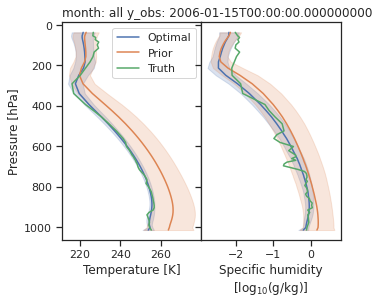

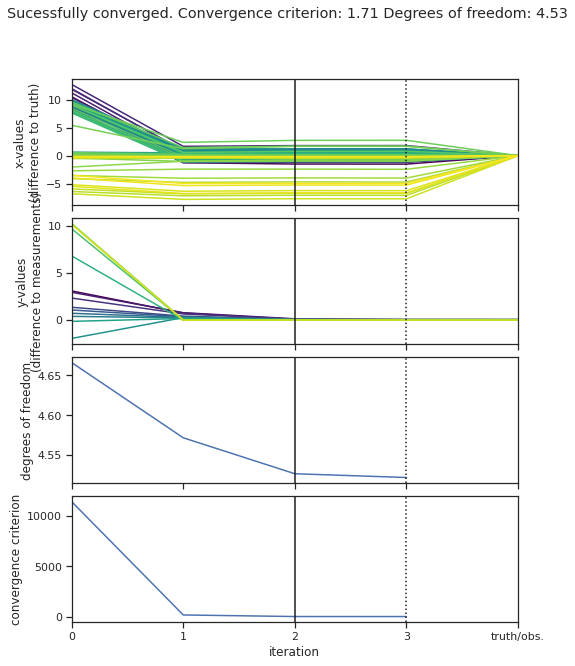

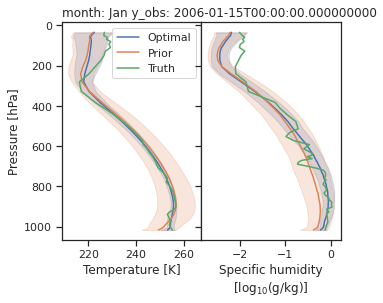

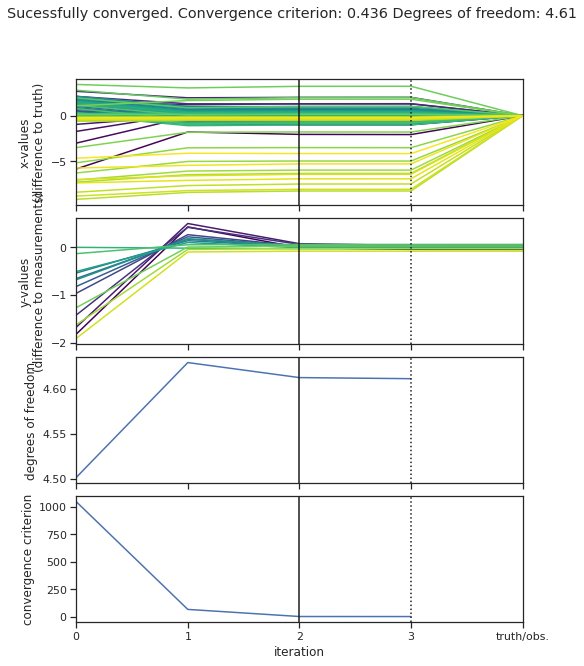

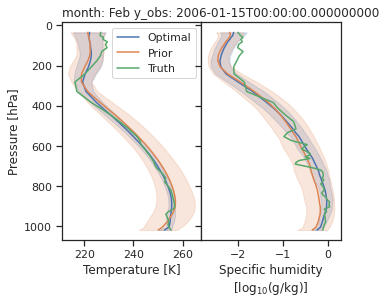

...

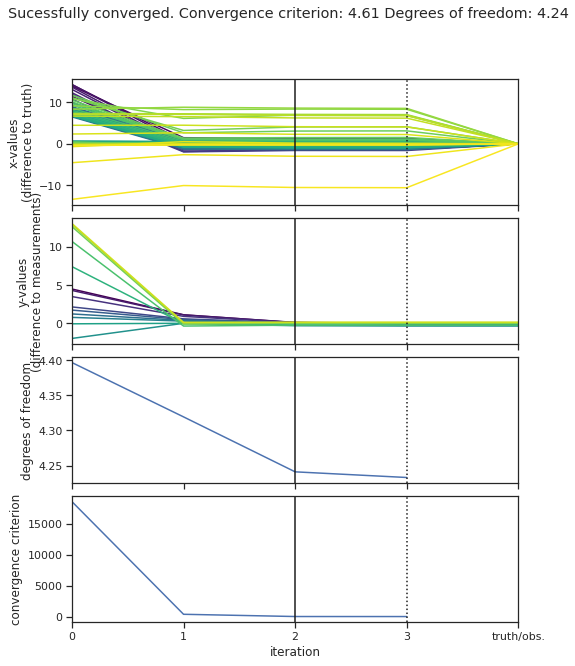

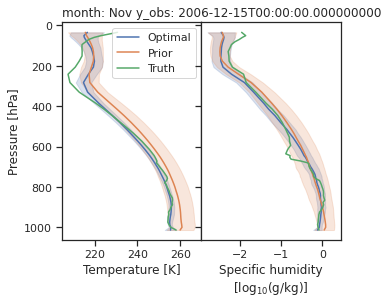

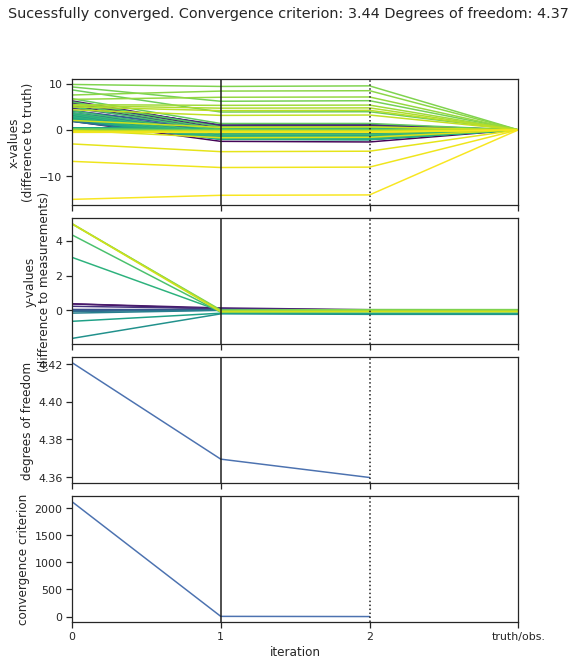

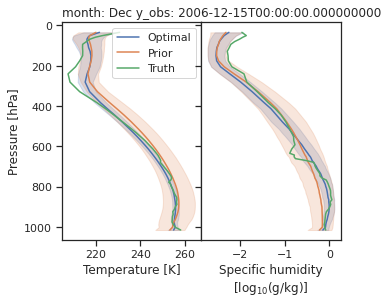

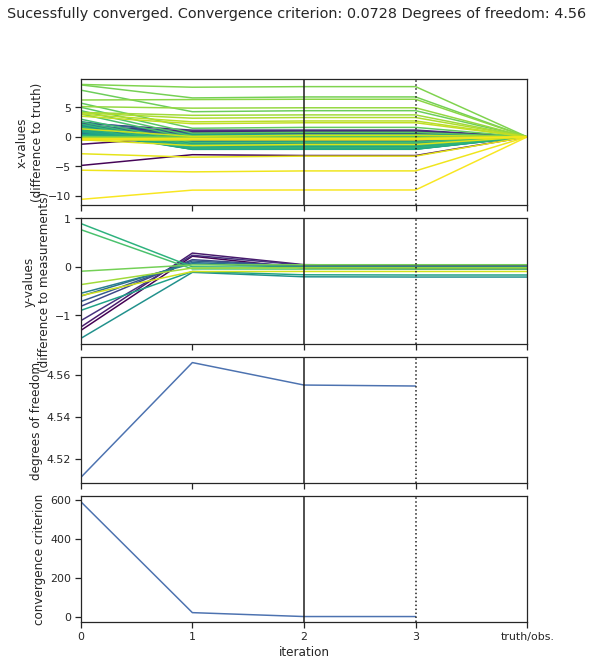

In [4]:
stat_month = pn.DataFrame()
stat_month.index = ['all'] + months
for Yobs_time in Yobs_times:
    profile = np.datetime64(Yobs_time)
    x_truth = x_truths.loc[profile]

    rms_month = []
    for Xa_month in stat_month.index:
        month = Xa_month
        x_a = x_mean.sel(month=Xa_month).to_pandas()[x_vars]
        S_a = x_cov.sel(month=Xa_month).to_pandas().loc[x_vars, x_vars]

        try:
            pyOE.invertMatrix(singularMatrix)
        except Exception as err:
            traceback.print_tb(err.__traceback__)

        forwardKwArgs = dict(
            pressure=pressure.loc[Xa_month].values,
            zenithAngle=0,
            frequencies=frequencies
        )

        y_obs = forwardRT(x_truth, **forwardKwArgs)
        y_obs = pn.Series(y_obs, index=y_vars)
        assert np.all(np.isfinite(y_obs))

        oe_ref = pyOE.optimalEstimation(
            x_vars, # state variable names
            x_a,  # a priori
            S_a, # a priori uncertainty
            y_vars,  # measurement variable names
            y_obs, # observations
            S_y, # observation uncertainty
            forwardRT, # forward Operator
            forwardKwArgs=forwardKwArgs, # additonal function arguments
            x_truth=x_truth, # true profile
        )
        try:
            oe_ref.doRetrieval()

            fig = supporting_routines.plotMwrResults(
                oe_ref,
                h=pressure.loc[month] / 100,
                hlabel='Pressure [hPa]',
                title='month: '+str(month) + ' y_obs: '+str(Yobs_time))
            fig.savefig('output/figures_q2_month/'+'result_'+'month_'+str(month)+'_y_obs_'+str(Yobs_time)[:10])

            fig = oe_ref.plotIterations(legend=False, mode='difference')
            fig.savefig('output/figures_q2_month/'+'iteration_'+'month_'+str(month)+'_y_obs_'+str(Yobs_time)[:10])

            T_optimal, Q_optimal = supporting_routines.splitTQ(oe_ref.x_op)
            T_truth, Q_truth = supporting_routines.splitTQ(oe_ref.x_truth)

            rms_month.append(np.sqrt(np.mean((10**Q_optimal - 10**Q_truth)**2)))
        except: rms_month.append(float('nan'))
    stat_month ['rms ' + str(Yobs_time)[:10]] = rms_month

In [5]:
stat_month.to_csv('output/rms_month.csv')
stat_month

,rms 2006-01-15,rms 2006-02-15,rms 2006-03-15,rms 2006-04-15,rms 2006-05-15,rms 2006-06-15,rms 2006-07-15,rms 2006-08-15,rms 2006-09-15,rms 2006-10-15,rms 2010-11-15,rms 2006-12-15
all,0.102728,0.256217,0.168374,0.088813,0.278754,NaN,0.219053,0.525170,NaN,0.254470,0.073292,0.098691
Jan,0.108383,NaN,0.146807,0.091594,NaN,NaN,NaN,NaN,NaN,0.251299,0.077194,0.096662
Feb,0.106618,NaN,0.170864,0.090720,NaN,NaN,NaN,NaN,NaN,0.283538,0.072416,0.093421
Mar,0.108408,NaN,0.158206,0.094008,NaN,NaN,NaN,NaN,NaN,0.301704,0.076831,0.096554
Apr,0.103365,NaN,0.170311,0.082398,0.224914,NaN,NaN,NaN,NaN,0.235748,0.074313,0.086946
May,0.102057,0.293405,0.172169,0.105829,0.183504,0.270203,0.259478,0.467909,NaN,0.249773,0.083815,0.109221
Jun,0.227715,0.410578,0.268722,0.256646,0.161279,0.257765,0.345905,0.470659,0.406916,0.270545,0.201574,0.266613
Jul,0.200839,0.351729,0.285251,0.228758,0.209690,0.352080,0.196746,0.478540,0.401647,0.244072,0.179446,0.239016
Aug,0.201734,0.429523,0.284215,0.234328,0.254601,0.350933,0.210648,0.497972,0.502422,0.294656,0.183493,0.248449
Sep,0.179957,0.360363,0.268370,0.202986,0.338687,0.364735,0.237432,0.508392,NaN,0.313739,0.155024,0.222187
